# Simulation study (Hyperparameter tuning) - Inference of tumour growth model in a virtual patient without treatment 

## Build tumour growth model

In [1]:
import erlotinib as erlo

# Define mechanistic model
path = erlo.ModelLibrary().tumour_growth_inhibition_model_koch_reparametrised()
mechanistic_model = erlo.PharmacodynamicModel(path)
mechanistic_model.set_parameter_names(names={
    'myokit.tumour_volume': 'Tumour volume in cm^3',
    'myokit.critical_volume': 'Critical volume in cm^3',
    'myokit.drug_concentration': 'Drug concentration in mg/L',
    'myokit.kappa': 'Potency in L/mg/day',
    'myokit.lambda': 'Exponential growth rate in 1/day'})

# Define error model
error_model = erlo.ConstantAndMultiplicativeGaussianErrorModel()

# Build model
problem = erlo.ProblemModellingController(
    mechanistic_model, error_model)
problem.fix_parameters({
    'Drug concentration in mg/L': 0,
    'Potency in L/mg/day': 0})

## Measure tumour volume in a virtual patient

In [2]:
import numpy as np

# Get predictive model
predictive_model = problem.get_predictive_model()

# Define a virtual patient
parameters = [
    0.22,  # Initial tumour volume
    3.76,  # Critical tumour volume
    0.13,  # Tumour growth rate
    0.04,  # Base noise
    0.1]   # Relative noise

# Take virtual measurements
seed = 42
times = np.linspace(0, 30, num=10)
n_samples = 1
data = predictive_model.sample(parameters, times, n_samples, seed)

### Visualise virtual measurements

In [3]:
# Create scatter plot
fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data, biomarker='myokit.tumour_volume', meas_key='Sample')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')

# Show figure
fig.show()

**Figure 1:** Visualisation of the measured tumour growth in a virtual patient.

## Build prior predictive model

In [4]:
import pints

# Define prior distribution
log_priors = [
    pints.HalfCauchyLogPrior(location=1, scale=1),     # Initial tumour volume
    pints.HalfCauchyLogPrior(location=0, scale=1),     # Critical tumour volume
    pints.HalfCauchyLogPrior(location=0, scale=1),     # Growth rate
    pints.HalfCauchyLogPrior(location=0, scale=1),     # Sigma base
    pints.HalfCauchyLogPrior(location=0, scale=0.1)]   # Sigma rel.
log_prior = pints.ComposedLogPrior(*log_priors)

# Define prior predictive model and sample 1000 virtual patients
model = erlo.PriorPredictiveModel(predictive_model, log_prior)
n_samples = 1000
samples = model.sample(times, n_samples, seed)

# Visualise prior predictive model
fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

**Figure 2:** Prior predictive model of tumour volume measurement over time. The shaded areas estimate the 0.3, 0.6 and 0.9 bulk probability of the prior predictive distribution by sampling 1000 virtual "measurements" at each of the time points.

## Find posterior probability distribution

In [5]:
# Create posterior
problem.set_data(
    data, meas_key='Sample', dose_key=None, dose_duration_key=None)
problem.set_log_prior(log_priors)
log_posterior = problem.get_log_posterior()

# Set up sampling controller
sampler = erlo.SamplingController(log_posterior)
sampler.set_transform(transform=pints.LogTransformation(n_parameters=5))
sampler.set_n_runs(5)

# Run sampling
n_iterations = 40000
posterior_samples = sampler.run(n_iterations=n_iterations, show_progress_bar=True)

## Reshape into arviz InferenceData

In [6]:
import xarray as xr

def to_xarray_dataset(data):
    """
    Takes a pandas.DataFrame with posterior samples and returns it in form of a xarray.Dataset.

    #TODO: Reference dataset is starting to count chains and draws with 0
    """
    # Get number of iterations and number of chains
    draws = data['Iteration'].unique()
    n_draws = len(draws)
    chains = data['Run'].unique()
    n_chains = len(chains)

    # Sort samples of parameters into xarrays
    container = {}
    parameter_names = data['Parameter'].unique()
    for param_id, parameter in enumerate(parameter_names):
        # Create conatiner for samples
        samples = np.empty(shape=(n_chains, n_draws), dtype=float)

        # Mask dataframe for parameter
        mask = data['Parameter'] == parameter
        temp = data[mask]

        # Fill samples for each chain
        for chain_id, chain in enumerate(chains):
            # Mask samples for chain and fill container
            mask = temp['Run'] == chain
            samples[chain_id] = temp[mask]['Sample'].to_numpy()

        # Convert samples to xarray and add to dictionary
        samples = xr.DataArray(
            data=samples,
            dims=['chain', 'draw'],
            coords={'chain': list(chains-1), 'draw': list(draws-1)})
        container[parameter] = samples

    # Convert to xarray.Dataset and return
    return xr.Dataset(container)

In [7]:
xarray_samples = to_xarray_dataset(posterior_samples)
xarray_samples

<xarray.Dataset>
Dimensions:                           (chain: 5, draw: 40000)
Coordinates:
  * chain                             (chain) int64 0 1 2 3 4
  * draw                              (draw) int64 0 1 2 3 ... 39997 39998 39999
Data variables:
    Tumour volume in cm^3             (chain, draw) float64 0.6687 ... 0.2187
    Critical volume in cm^3           (chain, draw) float64 1.681 ... 3.978
    Exponential growth rate in 1/day  (chain, draw) float64 9.448 ... 0.1273
    Sigma base                        (chain, draw) float64 0.05773 ... 0.02282
    Sigma rel.                        (chain, draw) float64 0.1181 ... 0.08195

### Find appropriate warmup and thinning hyperparameters

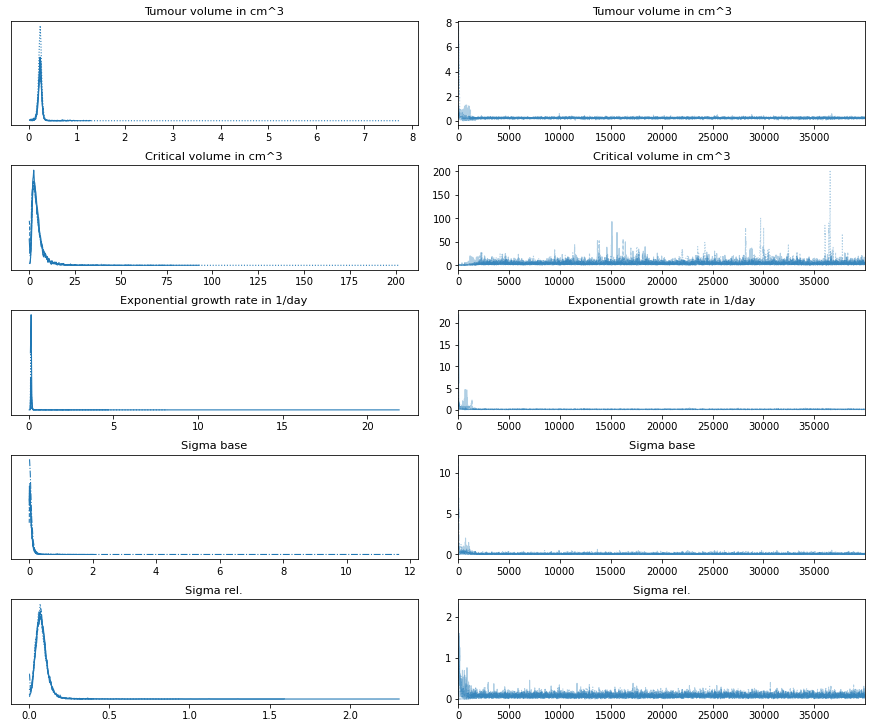

In [11]:
import arviz as az
import matplotlib.pyplot as plt

az.plot_trace(xarray_samples)
plt.show()

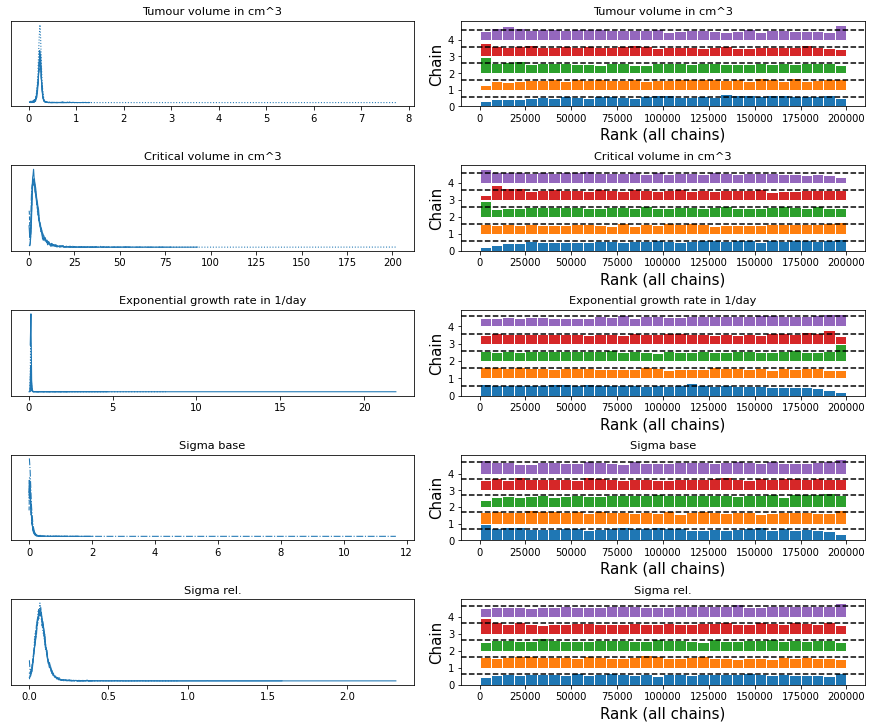

In [12]:
az.plot_trace(xarray_samples, kind='rank_bars')
plt.show()

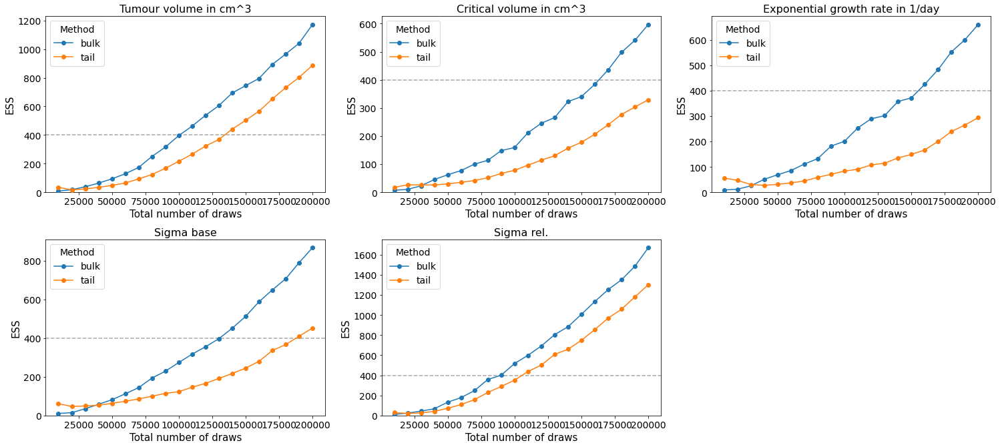

In [13]:
az.plot_ess(xarray_samples, kind="evolution")
plt.show()

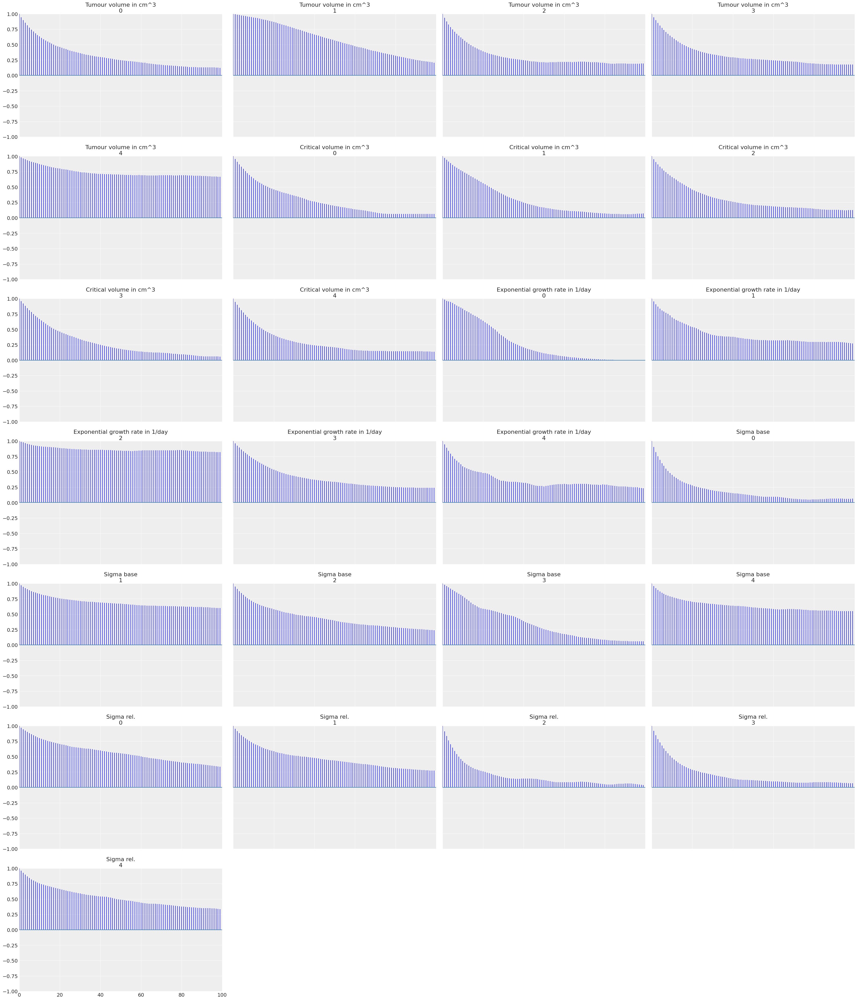

In [15]:
az.style.use("arviz-darkgrid")
az.plot_autocorr(xarray_samples)
plt.show()

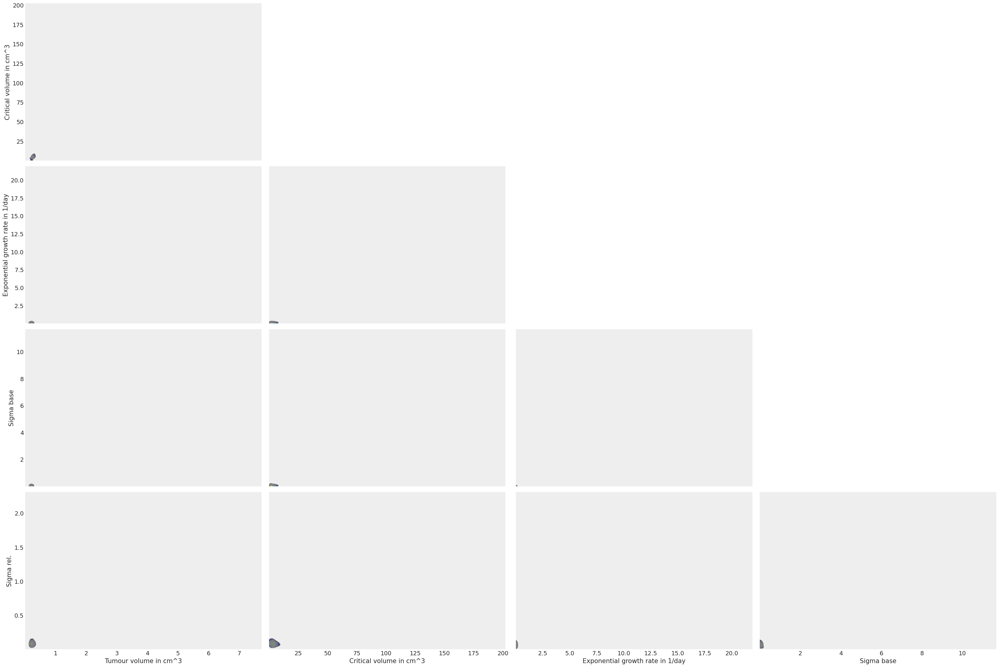

In [16]:
az.plot_pair(xarray_samples, kind="kde")
plt.show()

### Throw away warmup

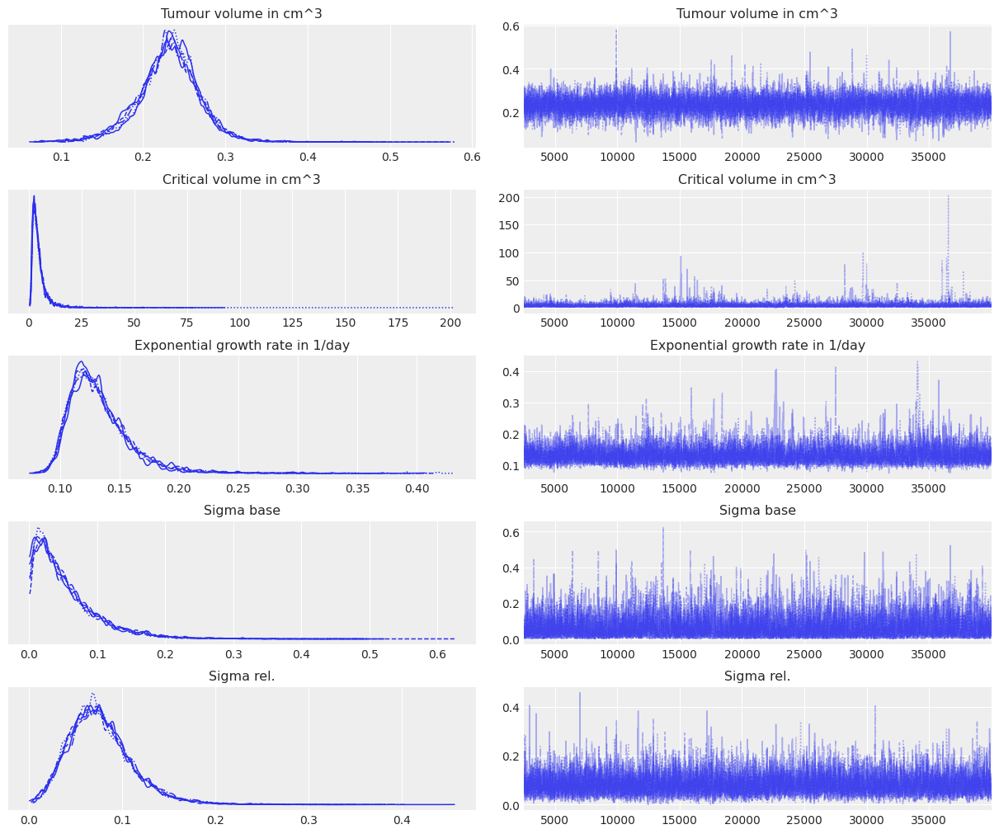

In [17]:
warmup = 2500

az.plot_trace(xarray_samples.isel(draw=slice(warmup, n_iterations)))
plt.show()

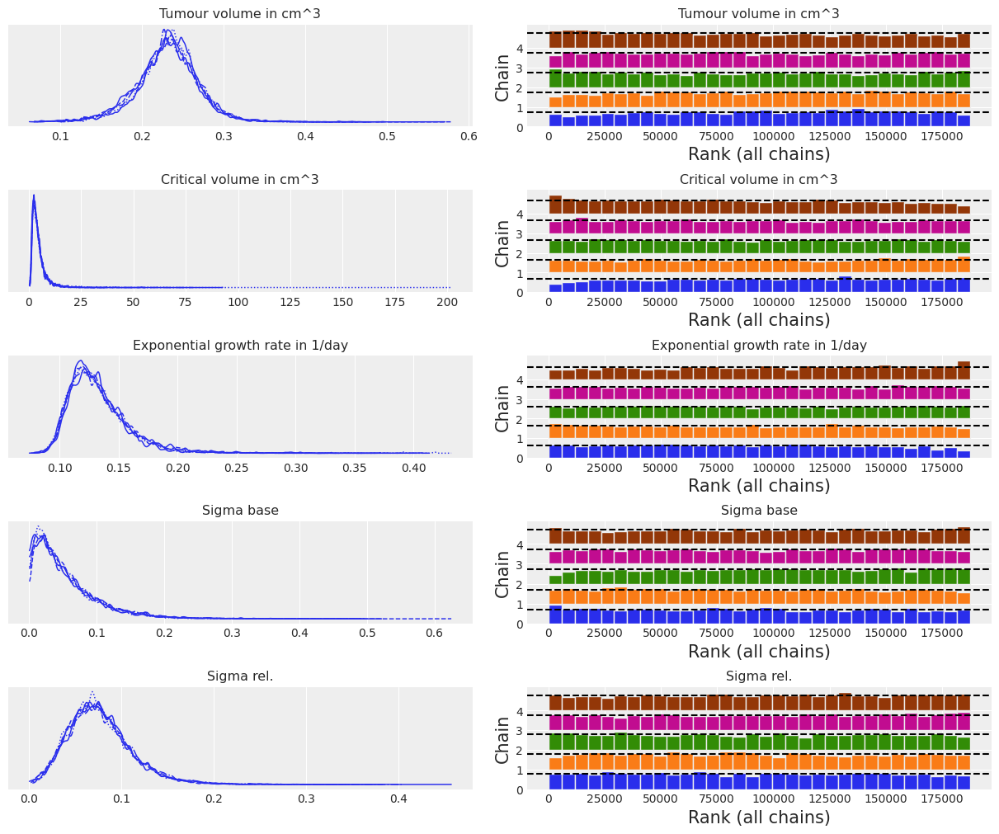

In [18]:
az.plot_trace(xarray_samples.isel(draw=slice(warmup, n_iterations)), kind='rank_bars')

plt.show()

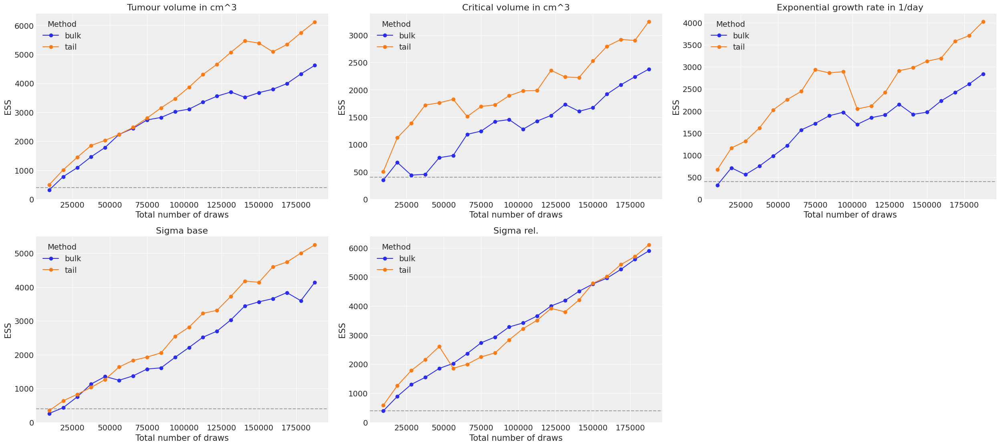

In [19]:
az.plot_ess(xarray_samples.isel(draw=slice(warmup, n_iterations)), kind="evolution")
plt.show()

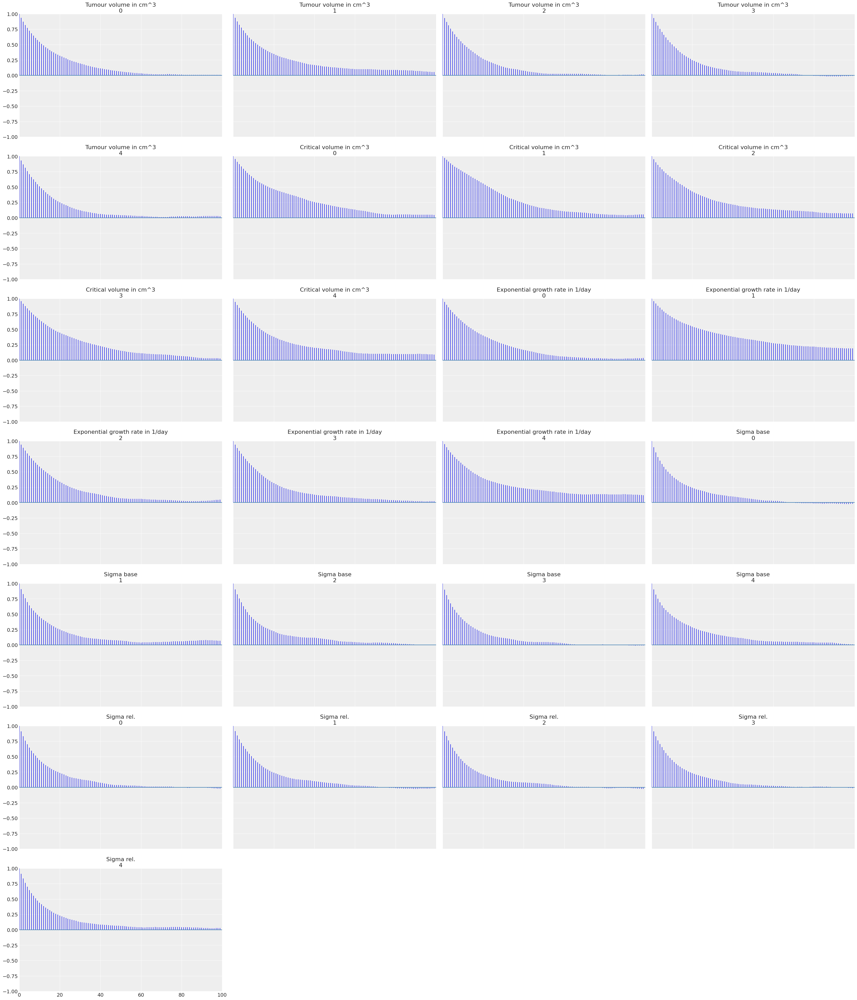

In [20]:
az.plot_autocorr(xarray_samples.isel(draw=slice(warmup, n_iterations)))
plt.show()

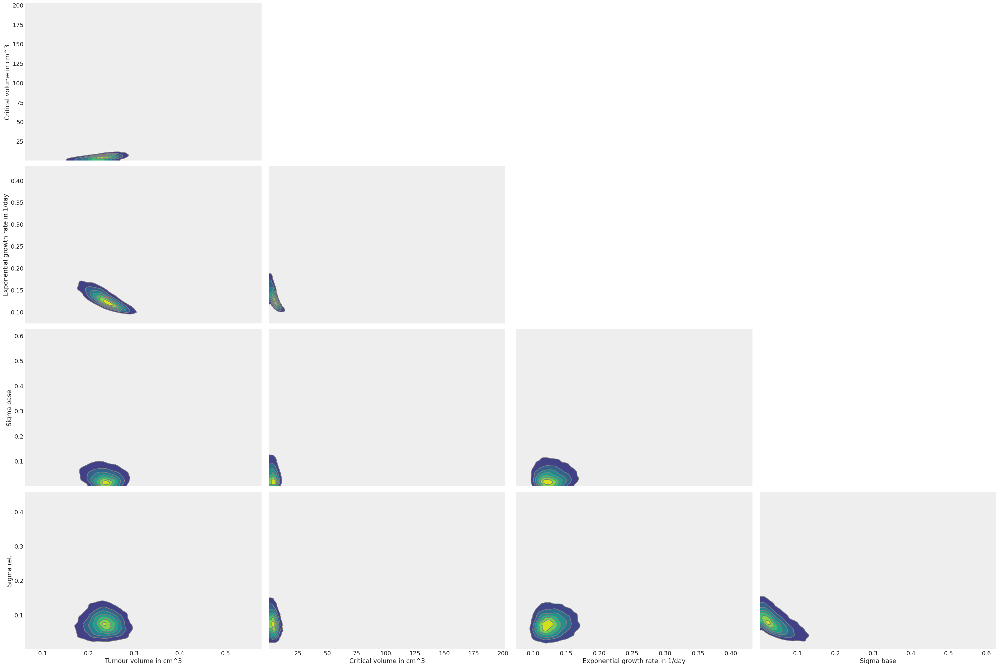

In [21]:
az.plot_pair(xarray_samples.isel(draw=slice(warmup, n_iterations)), kind="kde")
plt.show()

### Reduce autocorrelation by thinning out the samples

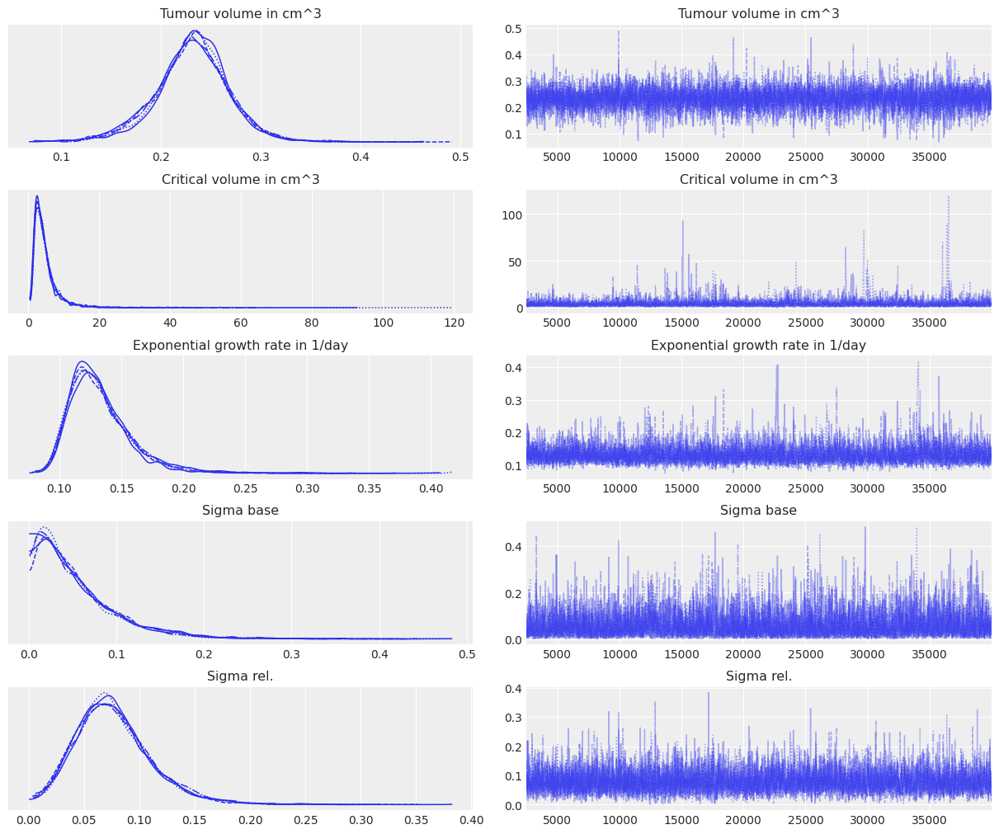

In [22]:
thinning_ratio = 10

az.plot_trace(xarray_samples.isel(draw=slice(warmup, n_iterations, thinning_ratio)))
plt.show()

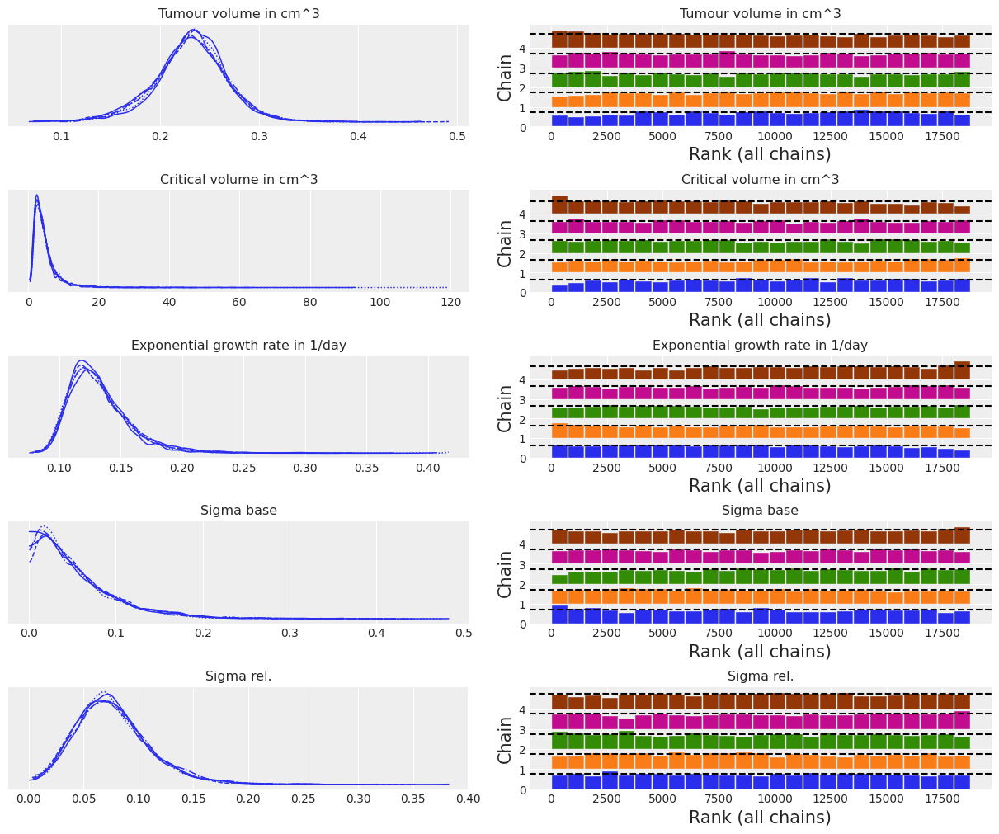

In [23]:
az.plot_trace(xarray_samples.isel(draw=slice(warmup, n_iterations, thinning_ratio)), kind='rank_bars')
plt.show()

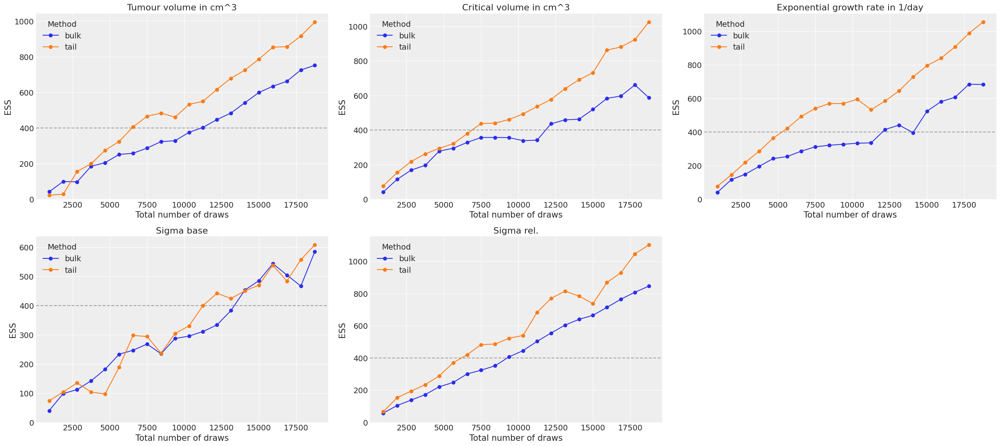

In [24]:
az.plot_ess(xarray_samples.isel(draw=slice(warmup, n_iterations, thinning_ratio)), kind="evolution")
plt.show()

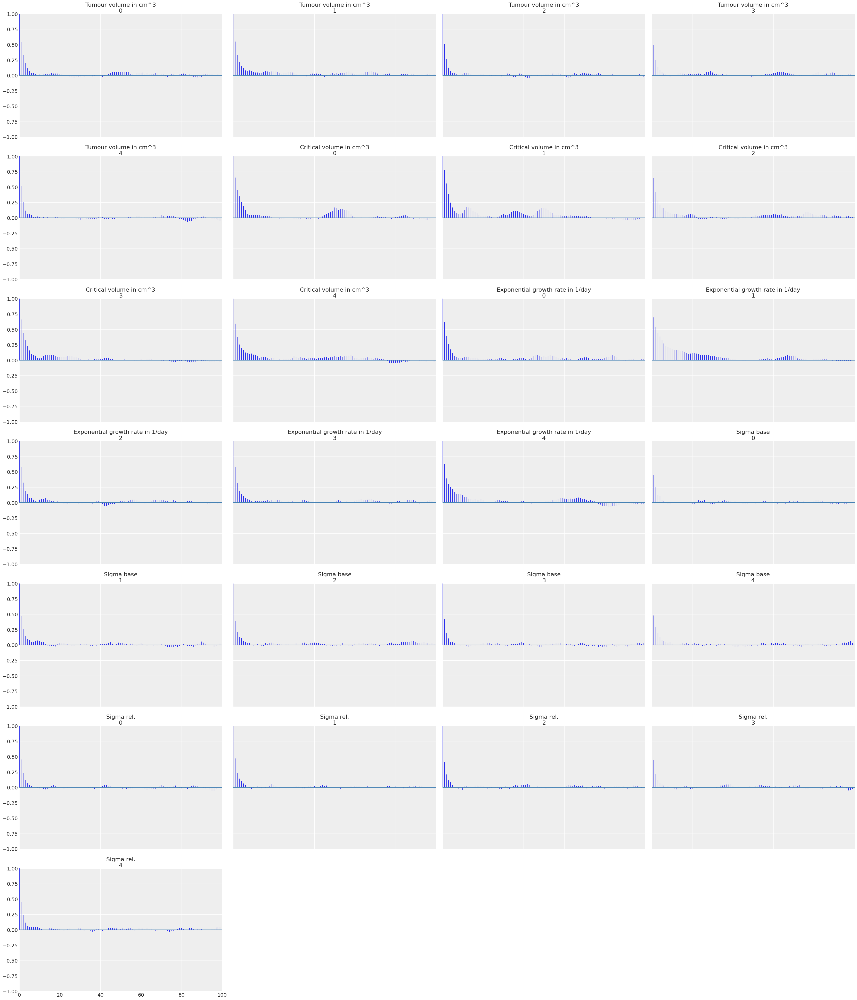

In [25]:
az.plot_autocorr(xarray_samples.isel(draw=slice(warmup, n_iterations, thinning_ratio)))
plt.show()

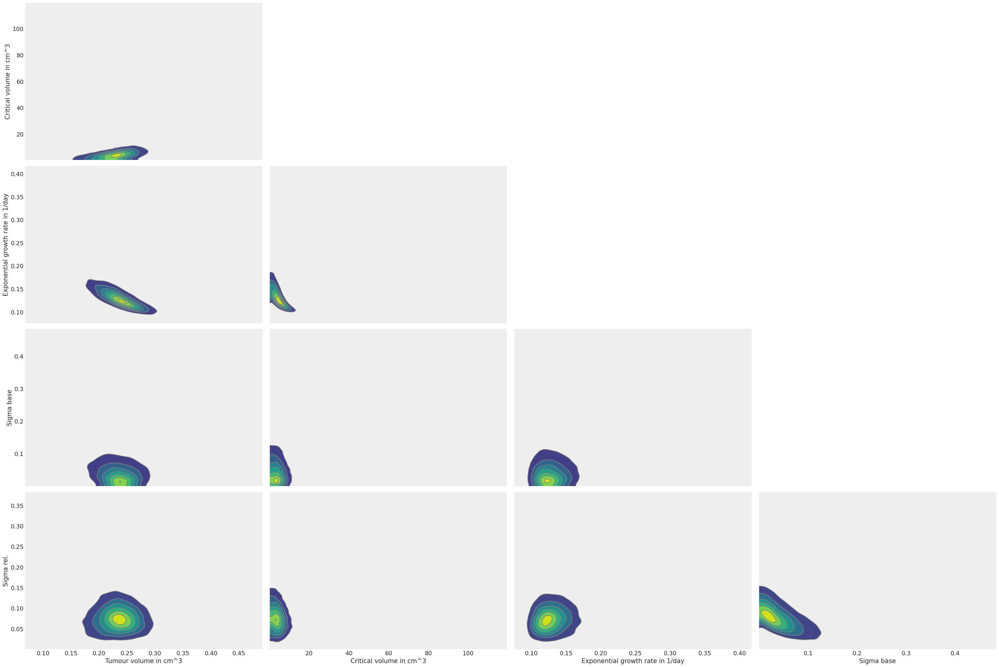

In [26]:
az.plot_pair(xarray_samples.isel(draw=slice(warmup, n_iterations, thinning_ratio)), kind="kde")
plt.show()

## Compare summaries

In [27]:
az.summary(xarray_samples)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
Tumour volume in cm^3,0.237,0.128,0.148,0.309,0.005,0.003,671.0,671.0,1171.0,886.0,1.00
Critical volume in cm^3,4.620,4.560,0.034,10.167,0.115,0.081,1574.0,1574.0,597.0,329.0,1.01
Exponential growth rate in 1/day,0.146,0.214,0.090,0.190,0.007,0.005,886.0,886.0,661.0,294.0,1.01
Sigma base,0.064,0.138,0.000,0.161,0.005,0.004,727.0,727.0,867.0,451.0,1.01
Sigma rel.,0.080,0.057,0.012,0.148,0.002,0.001,773.0,773.0,1670.0,1302.0,1.00


In [28]:
az.summary(xarray_samples.sel(draw=slice(warmup, n_iterations)))

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
Tumour volume in cm^3,0.231,0.037,0.156,0.300,0.001,0.000,4544.0,4544.0,4620.0,6120.0,1.0
Critical volume in cm^3,4.766,4.619,0.716,10.551,0.101,0.072,2073.0,2073.0,2378.0,3249.0,1.0
Exponential growth rate in 1/day,0.133,0.027,0.092,0.178,0.001,0.000,2340.0,1984.0,2842.0,4025.0,1.0
Sigma base,0.054,0.049,0.000,0.141,0.001,0.000,5938.0,5938.0,4141.0,5249.0,1.0
Sigma rel.,0.077,0.035,0.017,0.142,0.000,0.000,6596.0,6596.0,5895.0,6105.0,1.0


In [29]:
az.summary(xarray_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)))

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
Tumour volume in cm^3,0.231,0.037,0.156,0.300,0.001,0.000,4607.0,4607.0,4634.0,5700.0,1.0
Critical volume in cm^3,4.759,4.500,0.716,10.544,0.098,0.069,2117.0,2117.0,2464.0,3320.0,1.0
Exponential growth rate in 1/day,0.133,0.027,0.093,0.179,0.001,0.000,2349.0,1977.0,3010.0,3881.0,1.0
Sigma base,0.054,0.049,0.000,0.142,0.001,0.000,5623.0,5623.0,3909.0,4617.0,1.0
Sigma rel.,0.077,0.035,0.012,0.138,0.000,0.000,6361.0,6361.0,5698.0,5587.0,1.0


In [ ]:
parameters = [
    0.22,  # Initial tumour volume
    3.76,  # Critical tumour volume
    0.13,  # Tumour growth rate
    0.04,  # Base noise
    0.1]   # Relative noise